## 토픽 모델링
https://www.machinelearningplus.com/nlp/topic-modeling-visualization-how-to-present-results-lda-models/

In [2]:
# 필요한 라이브러리 호출
import time
import csv
import sys
# !{sys.executable} -m spacy download en
import re, numpy as np, pandas as pd
from pprint import pprint

# Gensim
import gensim, spacy, logging, warnings
import gensim.corpora as corpora
from gensim.utils import lemmatize, simple_preprocess
from gensim.models import CoherenceModel
import matplotlib.pyplot as plt

import seaborn as sns
import matplotlib.pyplot as plt

# NLTK Stop words
from nltk.corpus import stopwords
stop_words = stopwords.words('english')

import en_core_web_sm
nlp = en_core_web_sm.load()

%matplotlib inline
warnings.filterwarnings("ignore",category=DeprecationWarning)
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.ERROR)

In [4]:
# 필요한 데이터 수집
df = pd.read_csv("D:\\2020-2\\소프트웨어융합캡스톤디자인\\new_jupyter\\data2\\origin\\adhd_origin.csv")
#print("adhd: ", len(adhd))

#df = pd.read_csv("D:\\2020-2\\소프트웨어융합캡스톤디자인\\new_jupyter\\data2\\origin\\anxiety_origin.csv")
#print("anxiety: ", len(anxiety))
#df = pd.read_csv("D:\\2020-2\\소프트웨어융합캡스톤디자인\\new_jupyter\\data2\\origin\\bipolar_origin.csv")
#print("bipolar: ", len(bipolar))
#df = pd.read_csv("D:\\2020-2\\소프트웨어융합캡스톤디자인\\new_jupyter\\data2\\origin\\depression_origin.csv")
#print("depression: ", len(depression))
#df = pd.read_csv("D:\\2020-2\\소프트웨어융합캡스톤디자인\\new_jupyter\\data2\\origin\\schizo_origin.csv")
#print("schizo: ", len(schizo))
#df = pd.read_csv("D:\\2020-2\\소프트웨어융합캡스톤디자인\\new_jupyter\\data2\\origin\\non_mh_origin.csv")
#print("health: ", len(non_mh))

In [3]:
df.head()

,Unnamed: 0,subreddit,author,title,text_context,date,content
0,0,ADHD,pancakesiguess,I got my degree today!,I now have an associates degree in Electronics...,2020-09-24 08:56:09,I got my degree today! I now have an associate...
1,1,ADHD,pancakesiguess,"Hyperfocused too much and got told off for it,...",I recently got a 1960s Sunbeam Radiant Control...,2020-07-17 02:01:04,"Hyperfocused too much and got told off for it,..."
2,2,ADHD,pancakesiguess,I haven't been taking my meds regularly and no...,Title says it all. I've been furloughed since ...,2020-05-04 11:56:06,I haven't been taking my meds regularly and no...
3,3,ADHD,pancakesiguess,"I have a good memory, but it's permanently set...",I can't remember that I need to turn the laund...,2020-05-01 02:18:09,"I have a good memory, but it's permanently set..."
4,4,ADHD,pancakesiguess,My Quarantine Schedule,I have a manufacturing job for a small company...,2020-03-24 08:01:04,My Quarantine Schedule I have a manufacturing ...


In [9]:
# 전처리 

def sent_to_words(sentences):
    for sent in sentences:
        sent = re.sub('\S*@\S*\s?', '', sent)  # remove emails
        sent = re.sub("\'", "", sent)  # remove single quotes
        shortword = re.compile(r'\W*\b\w{1,2}\b')
        shortword_content = shortword.sub('', sent)
        sent = re.sub('[-=.#/?:$}!,@]', '', shortword_content)
        sent = sent.replace("*", "")
        sent = sent.replace(")", "")
        sent = sent.replace("(", "")
        sent = sent.replace(";", "")
        sent = sent.replace("&", "")
        sent = sent.replace("amp", "")
        sent = sent.replace("nbsp", "")
        sent = gensim.utils.simple_preprocess(str(sent), deacc=True) 
        yield(sent)  

# Convert to list
data = df.content.values.tolist()
data_words = list(sent_to_words(data)) 

#### ** n-gram

unigrams : an, adorable, little, boy, is, spreading, smiles    
bigrams : an adorable, adorable little, little boy, boy is, is spreading, spreading smiles    
trigrams : an adorable little, adorable little boy, little boy is, boy is spreading, is spreading smiles   
4-grams : an adorable little boy, adorable little boy is, little boy is spreading, boy is spreading smiles    

In [10]:
# bigram -> n=2인 n 그램
# trigram model 

bigram = gensim.models.Phrases(data_words, min_count=5, threshold=100) # higher threshold fewer phrases.
trigram = gensim.models.Phrases(bigram[data_words], threshold=100)  
bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)

python -m spacy download en

In [11]:
# stopword 제거 
stop_words = stopwords.words('english')

def process_words(texts, stop_words=stop_words, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
    """Remove Stopwords, Form Bigrams, Trigrams and Lemmatization"""
    texts = [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]
    texts = [bigram_mod[doc] for doc in texts]
    texts = [trigram_mod[bigram_mod[doc]] for doc in texts]
    texts_out = []
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    # remove stopwords once more after lemmatization
    texts_out = [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts_out]    
    return texts_out

data_ready = process_words(data_words)  # processed Text Data!

### LDA의 파라미터 조정

1) topic : 당신이 가설로 잡은 토픽의 갯수는?   
2) chunksize : 얼마나 많은 문서가 훈련 알고리즘에 사용되는가?   
  - 만약에 빠른 학습이 중요하시다면, 청크사이즈를 키워서 돌려봅시다!    
  - Hoffman의 논문에 의하면 Chunksize는 모델 품질에 영향을 미치지만 차이그 그렇게 크진 않다고 합니다!    
  
3) passes : 패스는 모델 학습시 전체 코퍼스에서 모델을 학습시키는 빈도를 제어한다고 합니다.
  - epochs 와 같은 용어 같다!
  - model를 학습시키는 횟수를 말하는것 같아요! model sampling?    
  
  
4) iteration : 각각 문서에 대해서 루프를 얼마나 돌리는지를 제어한다고 합니다.    
5) pass & iteration 은 최대한 많은게 좋다!    
6) eval_every = 1 in LdaModel   
7) alpha, eta = auto, 디리클레 분포의 감마함수에 대한 파라미터입니다!   


https://coredottoday.github.io/2018/09/17/%EB%AA%A8%EB%8D%B8-%ED%8C%8C%EB%9D%BC%EB%AF%B8%ED%84%B0-%ED%8A%9C%EB%8B%9D/

## LDA 파라미터 조절을 위한 기준

1) Perplexity: 언어 모델을 평가하기 위한 내부 평가 지표(헷갈리는 정도)     
  - 낮을수록 언어의 모델의 성능이 좋다.  
  - PPL의 값이 낮다고 해서 높은 정확도를 보인다는 것이지, 사람이 직접 느끼기에 좋은 언어 모델이라는 것을 의미하진 않는다.
  - https://settlelib.tistory.com/55
  
2) Cohenrence: 유사도
  - 높을수록 언어 모델의 성능이 좋다.

In [12]:
with open("D:\\2020-2\\소프트웨어융합캡스톤디자인\\new_jupyter\\data2\\add_prepeocess_worddata.csv",'w', newline='', encoding = 'utf-8') as f: 
    makewrite = csv.writer(f) 
    for value in data_ready: 
        makewrite.writerow(value)

In [5]:
data_ready = []
f = open("D:\\2020-2\\소프트웨어융합캡스톤디자인\\new_jupyter\\data2\\adhd_prepeocess_worddata.csv","rt", encoding = 'utf-8')
reader = csv.reader(f)
for row in reader :
    data_ready.append(row)

In [6]:
id2word = corpora.Dictionary(data_ready)
corpus = [id2word.doc2bow(text) for text in data_ready]

# 하이퍼파라미터 조절

In [4]:
coherences=[]
perplexities=[]
passes=[]

for i in range(10):    
    ntopics= 10
    if i==0:
        p=1
    else:
        p=i*5
    tic = time.time()
    lda4 = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=ntopics, 
                                           passes = p,
                                           iterations = 100)
    print("i: ", i)
     
    print('epoch',p,time.time() - tic)
    # tfidf, corpus 무슨 차이?
    # lda = models.ldamodel.LdaModel(corpus, id2word=dictionary, num_topics=ntopics, iterations=200000)

    cm = CoherenceModel(model=lda4, corpus=corpus, coherence='u_mass')
    coherence = cm.get_coherence()
    print("Cpherence",coherence)
    coherences.append(coherence)
    print('Perplexity: ', lda4.log_perplexity(corpus),'\n\n')
    perplexities.append(lda4.log_perplexity(corpus))

i:  0
epoch 1 20.289018154144287
Cpherence -1.6870332654459506
Perplexity:  -7.842933843505272 


i:  1
epoch 5 75.10567021369934
Cpherence -4.2522124013044404
Perplexity:  -7.734630223444866 


i:  2
epoch 10 134.7378146648407
Cpherence -3.1032362280672734
Perplexity:  -7.718161975212615 


i:  3
epoch 15 195.03878474235535
Cpherence -2.8488528298242968
Perplexity:  -7.704584646604755 


i:  4
epoch 20 241.81643867492676
Cpherence -2.3575091254201492
Perplexity:  -7.689887079385257 


i:  5
epoch 25 298.5168614387512
Cpherence -5.107780948551555
Perplexity:  -7.708205851527224 


i:  6
epoch 30 350.73148250579834
Cpherence -1.9887292557564262
Perplexity:  -7.683238669361067 


i:  7
epoch 35 416.61936497688293
Cpherence -3.160681824124615
Perplexity:  -7.686083714975232 


i:  8
epoch 40 461.43326210975647
Cpherence -4.252773186530374
Perplexity:  -7.688081188475715 


i:  9
epoch 45 509.4002640247345
Cpherence -2.7578060323795843
Perplexity:  -7.67915005623262 




Text(0.5, 0, 'passes')

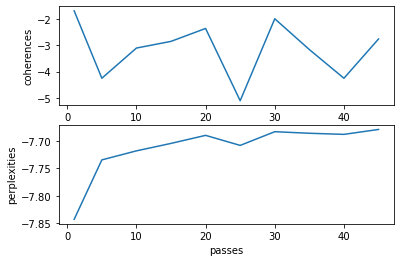

In [5]:
passes = [1, 5, 10, 15, 20, 25, 30, 35, 40, 45]
coherences
perplexities

fig = plt.figure()
ax1 = fig.add_subplot(2, 1, 1)
ax2 = fig.add_subplot(2, 1, 2)

ax1.plot(passes, coherences)
ax1.set_ylabel("coherences")
ax2.plot(passes, perplexities)
ax2.set_ylabel("perplexities")
ax2.set_xlabel("passes")

In [6]:
coherencesT=[]
perplexitiesT=[]
topic_n=[]
warnings.filterwarnings('ignore')

for i in range(2,20):
    topic_n.append(i)
    nwords = 100
    tic = time.time()
    lda4 = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=i, 
                                           passes = 20,
                                           iterations = 100)
    print('ntopics',i,time.time() - tic)

    cm = CoherenceModel(model=lda4, corpus=corpus, coherence='u_mass')
    coherence = cm.get_coherence()
    print("Cpherence",coherence)
    coherencesT.append(coherence)
    print('Perplexity: ', lda4.log_perplexity(corpus),'\n\n')
    perplexitiesT.append(lda4.log_perplexity(corpus))

ntopics 2 323.2017180919647
Cpherence -1.233534289756527
Perplexity:  -7.331992016048025 


ntopics 3 282.4739468097687
Cpherence -1.420957124274694
Perplexity:  -7.323285713095296 


ntopics 4 271.6997768878937
Cpherence -1.5070567505157344
Perplexity:  -7.332420085509707 


ntopics 5 255.1019208431244
Cpherence -1.7343026663234435
Perplexity:  -7.360564484393403 


ntopics 6 272.02961778640747
Cpherence -2.2322011874136805
Perplexity:  -7.397529166879029 


ntopics 7 259.39880990982056
Cpherence -2.1313168804042553
Perplexity:  -7.432792865850704 


ntopics 8 252.42260336875916
Cpherence -3.4510523066643657
Perplexity:  -7.485542650621247 


ntopics 9 293.27144503593445
Cpherence -1.802852676441404
Perplexity:  -7.5723028441217535 


ntopics 10 272.4071593284607
Cpherence -2.3840016224927583
Perplexity:  -7.700383294050598 


ntopics 11 278.5062973499298
Cpherence -2.5197363799452583
Perplexity:  -7.866685670770876 


ntopics 12 293.4638977050781
Cpherence -3.4159200957706504
Perplex

Text(0.5, 0, 'n_topic')

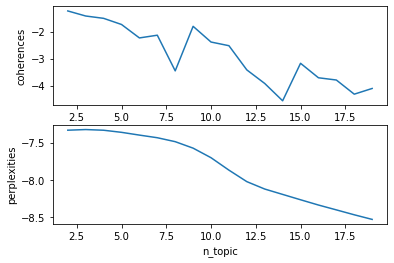

In [7]:

fig = plt.figure()
ax1 = fig.add_subplot(2, 1, 1)
ax2 = fig.add_subplot(2, 1, 2)

ax1.plot(topic_n, coherencesT)
ax1.set_ylabel("coherences")
ax2.plot(topic_n, perplexitiesT)
ax2.set_ylabel("perplexities")
ax2.set_xlabel("n_topic")

##  LDA 수행

In [5]:
# Create Dictionary
id2word = corpora.Dictionary(data_ready)

# Create Corpus: Term Document Frequency
corpus = [id2word.doc2bow(text) for text in data_ready]

# Build LDA model
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=4, 
                                           passes=30,
                                           iterations=100,
                                           per_word_topics=True)

print(lda_model.print_topics())
some_topic

[(0, '0.033*"take" + 0.032*"day" + 0.027*"feel" + 0.020*"work" + 0.016*"get" + 0.016*"hour" + 0.014*"time" + 0.013*"sleep" + 0.013*"med" + 0.012*"start"'), (1, '0.016*"medication" + 0.014*"take" + 0.013*"doctor" + 0.011*"experience" + 0.011*"symptom" + 0.010*"say" + 0.010*"med" + 0.010*"get" + 0.010*"help" + 0.010*"see"'), (2, '0.020*"feel" + 0.015*"thing" + 0.014*"know" + 0.013*"think" + 0.012*"get" + 0.011*"people" + 0.011*"make" + 0.011*"really" + 0.010*"life" + 0.010*"time"'), (3, '0.019*"time" + 0.014*"get" + 0.014*"thing" + 0.013*"work" + 0.011*"week" + 0.010*"start" + 0.010*"day" + 0.009*"write" + 0.009*"class" + 0.009*"good"')]


In [1]:
# 모델 저장 및 불러오기
import pickle
#with open("da_model_adhd.pk","wb") as f:
#    pickle.dump(lda_model, f)
    

# then reload it with
with open('model/lda_model_adhd.pk', 'rb') as f:
    lda_model = pickle.load(f)

In [17]:
# 문서별로 어떤 토픽이 가장 높은지 확인하는 문서 생성

def format_topics_sentences(ldamodel=None, corpus=corpus, texts=data_ready):
    # Init output
    sent_topics_df = pd.DataFrame()

    # Get main topic in each document
    for i, row_list in enumerate(ldamodel[corpus]):
        row = row_list[0] if ldamodel.per_word_topics else row_list            
        # print(row)
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    sent_topics_df = pd.concat([sent_topics_df, contents], axis=1)
    return(sent_topics_df)


df_topic_sents_keywords = format_topics_sentences(ldamodel=lda_model, corpus=corpus, texts=data_ready)

# Format
df_dominant_topic = df_topic_sents_keywords.reset_index()
df_dominant_topic.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text']
df_dominant_topic.head(10)

,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text
0,0,3.0,0.9587,"time, get, thing, work, week, start, day, writ...","[get, degree, today, electronic, engineering, ..."
1,1,2.0,0.9719,"feel, thing, know, think, get, people, make, r...","[hyperfocuse, much, get, tell, feel, depressed..."
2,2,0.0,0.7311,"take, day, feel, work, get, hour, time, sleep,...","[take, med, regularly, right, work, restart, f..."
3,3,3.0,0.5151,"time, get, thing, work, week, start, day, writ...","[good, memory, permanently, set, random, stora..."
4,4,0.0,0.5832,"take, day, feel, work, get, hour, time, sleep,...","[schedule, manufacturing, job, small, company,..."
5,5,2.0,0.7773,"feel, thing, know, think, get, people, make, r...","[still, chase, rainbow, issue, motivation, pro..."
6,6,3.0,0.4834,"time, get, thing, work, week, start, day, writ...","[lose, drive, find, week, later, save, year, w..."
7,7,2.0,0.7966,"feel, thing, know, think, get, people, make, r...","[bad, memory, sometimes, good, made, reservati..."
8,8,0.0,0.5512,"take, day, feel, work, get, hour, time, sleep,...","[clean, room, hate, cleaning, room, try, organ..."
9,9,3.0,0.5292,"time, get, thing, work, week, start, day, writ...","[want, sleep, brain, go, sleep, brain, sing, c..."


In [20]:
df_dominant_topic = pd.merge(df_dominant_topic, df['content'], left_index=True, right_index=True, how='inner')

In [21]:
final_result = []
for i, row_list in enumerate(lda_model[corpus]):
    row = row_list[0] if lda_model.per_word_topics else row_list  
    result = []
    for x, y in row:
        result.append(y)
    final_result.append(result)
topic_df = pd.DataFrame(final_result, columns = ["topic_1", "topic_2", "topic_3", "topic_4"]) # , "topic_5"]) #, "topic_6"])
topic_df = pd.merge(df_dominant_topic, topic_df, left_index=True, right_index=True, how='inner')

In [22]:
topic_df.to_csv("D:\\2020-2\\소프트웨어융합캡스톤디자인\\new_jupyter\\data2\\LDA\\adhd_lda.csv")

In [13]:
topic_df.head()

,Unnamed: 0,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,content,topic_1,topic_2,topic_3,topic_4
0,0,0,3.0,0.9587,"time, get, thing, work, week, start, day, writ...","['get', 'degree', 'today', 'electronic', 'engi...",I got my degree today! I now have an associate...,0.013908,0.013770,0.013647,0.958674
1,1,1,2.0,0.9719,"feel, thing, know, think, get, people, make, r...","['hyperfocuse', 'much', 'get', 'tell', 'feel',...","Hyperfocused too much and got told off for it,...",0.025418,0.971861,NaN,NaN
2,2,2,0.0,0.7311,"take, day, feel, work, get, hour, time, sleep,...","['take', 'med', 'regularly', 'right', 'work', ...",I haven't been taking my meds regularly and no...,0.731105,0.157078,0.106096,NaN
3,3,3,3.0,0.5151,"time, get, thing, work, week, start, day, writ...","['good', 'memory', 'permanently', 'set', 'rand...","I have a good memory, but it's permanently set...",0.456187,0.014084,0.014649,0.515080
4,4,4,0.0,0.5832,"take, day, feel, work, get, hour, time, sleep,...","['schedule', 'manufacturing', 'job', 'small', ...",My Quarantine Schedule I have a manufacturing ...,0.583219,0.203061,0.212228,NaN


In [24]:
# 각 문서별로 대표하는 문서 찾기
pd.options.display.max_colwidth = 100

sent_topics_sorteddf_mallet = pd.DataFrame()
sent_topics_outdf_grpd = df_topic_sents_keywords.groupby('Dominant_Topic')

for i, grp in sent_topics_outdf_grpd:
    sent_topics_sorteddf_mallet = pd.concat([sent_topics_sorteddf_mallet, 
                                             grp.sort_values(['Perc_Contribution'], ascending=False).head(1)], 
                                            axis=0)

# Reset Index    
#sent_topics_sorteddf_mallet.reset_index(drop=True, inplace=True)

# Format
sent_topics_sorteddf_mallet.columns = ['Topic_Num', "Topic_Perc_Contrib", "Keywords", "Representative Text"]

# Show
sent_topics_sorteddf_mallet.head(10)

,Topic_Num,Topic_Perc_Contrib,Keywords,Representative Text
3685,0.0,0.9900,"take, day, feel, work, get, hour, time, sleep, med, start","[make, quick, salad, lunch, today, happen, take, far, long, decide, make, salad, lunch, today, g..."
48060,1.0,0.9924,"medication, take, doctor, experience, symptom, say, med, get, help, see","[take, test, think, well, worry, ill, false, negative, go, take, variety, relate, test, suppose,..."
42177,2.0,0.9962,"feel, thing, know, think, get, people, make, really, life, time","[attribute, personality, say, comment, think, make, good, post, lot, people, annoy, attribute, e..."
48009,3.0,0.9958,"time, get, thing, work, week, start, day, write, class, good","[decide, reasonable, context, grant, accommodation, university, student, declare, request, accom..."


In [29]:
topic_1 = df_dominant_topic['content'].iloc[3685]
topic_2 = df_dominant_topic['content'].iloc[48060]
topic_3 = df_dominant_topic['content'].iloc[42177]
topic_4 = df_dominant_topic['content'].iloc[48009]
#topic_5 = df_dominant_topic['content'].iloc[3434]
#topic_6 = df_dominant_topic['content'].iloc[294377]
#topic_7 = df_dominant_topic['content'].iloc[19172]

lists = [topic_1, topic_2, topic_3, topic_4] #, topic_5] #, topic_6]#, topic_7]

count = 0
for i in lists:
    print("Topic", count, ": ", i, "\n")
    print("_______________________________")
    count = count +1 

Topic 0 :  How to make a quick salad for lunch today. (With ADHD) TL,DR  procrastinating happened and it took far too long. 


I decided to make a salad for lunch today. Yum!

Get the lettuce out of the fridge
Grab a bunch of cherry toms out the fridge
Ham
Cheese
Some olives

Grab a chopping board from the cupboard 
Go to get knife from drawer, no knife, it’s in dishwasher. 
Open dishwasher and grab coffee cup (travel mug) 

Fill kettle and flick it on
Open cupboard to find multi vits 
Get a glass and fill with water, drop in multivitamin 

Throw some salad in Tupperware 
Let the dog out
Chase daughter down hall 
Put tv on for her
Back to the kitchen

Kettle is boiled. 
Spoon full of coffee in, go to get milk from fridge
Grab salad dressing
Chop up some ingredients. Still no knife! Grab knife from dishwasher, chop ingredients 

Pour boiled water into travel mug and then drink multivitamin drink. 
Stir in milk to coffee


Throw chopped ingredients into Tupperware and dress with sauce. F

C:\Users\samsung\AppData\Local\Programs\Python\Python36\lib\site-packages\ipykernel_launcher.py:8: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  


Text(0, 0.5, 'num of document')

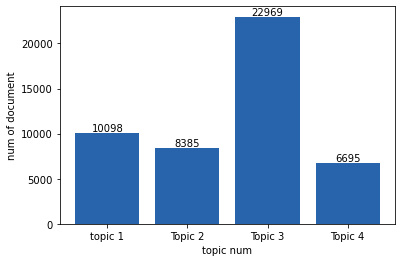

In [26]:
x = ["topic 1", "Topic 2", "Topic 3", "Topic 4"]
color = ['#2764AC'] #, '#77A0CF'
plt.bar(x, df_group['Document_No'], color = color)

for x ,y in zip(df_group.index, df_group['content']):
    plt.text(x, y, y, ha = 'center', va = 'bottom')
    
ax = plt.subplot()
ax.set_xticks([0, 1, 2, 3])
ax.set_xticklabels(["topic 1", "Topic 2", "Topic 3", "Topic 4"])

plt.xlabel("topic num")
plt.ylabel("num of document")

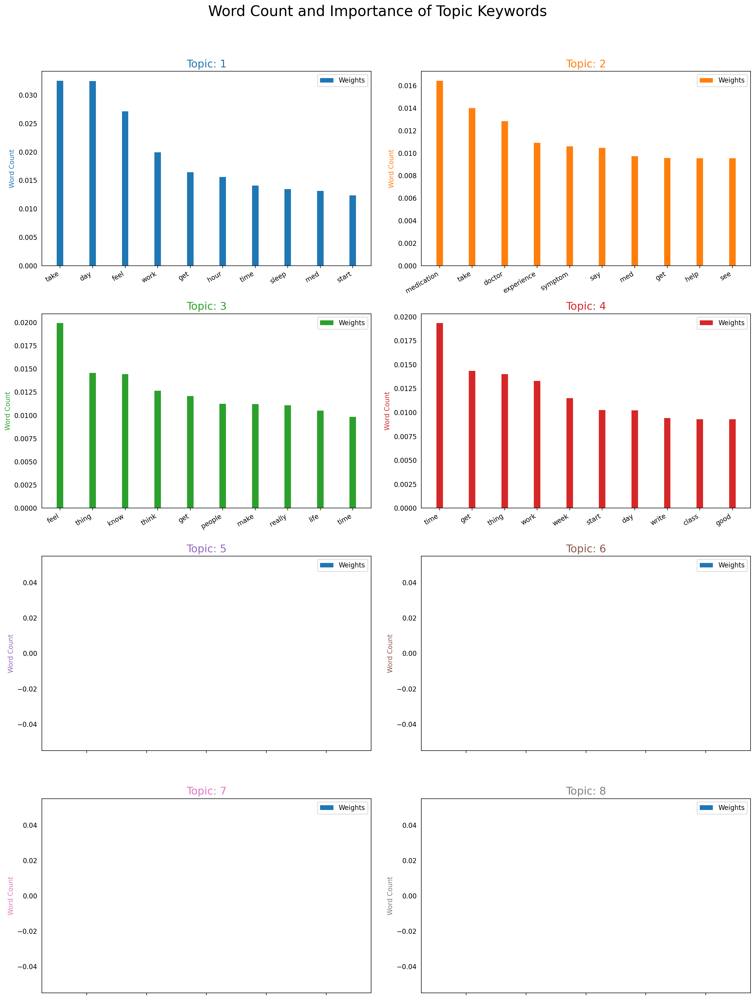

In [28]:
from collections import Counter
import seaborn as sns
import matplotlib.colors as mcolors
topics = lda_model.show_topics(formatted=False)
data_flat = [w for w_list in data_ready for w in w_list]
counter = Counter(data_flat)

out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        

# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(4, 2, figsize=(16,20), sharey=False, dpi=160)
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="importance", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    #ax_twin.set_ylim(0, 0.030); ax.set_ylim(0, 3500)
    ax.set_title('Topic: ' + str(i+1), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper right')

fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords', fontsize=22, y=1.05)    
#plt.show()
plt.savefig("D:\\2020-2\\소프트웨어융합캡스톤디자인\\new_jupyter\\data2\\LDA\\result\\adhd_lda.png")

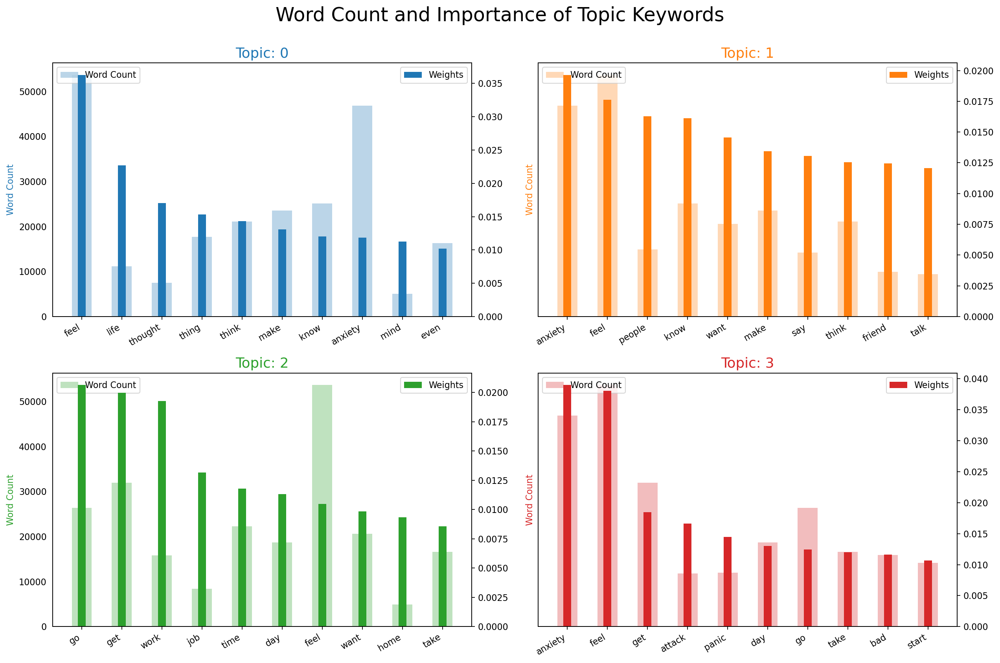

In [31]:
from collections import Counter
topics = lda_model.show_topics(formatted=False)
data_flat = [w for w_list in data_ready for w in w_list]
counter = Counter(data_flat)

out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        

# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(2, 2, figsize=(16,10), sharey=True, dpi=160)
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.5, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    #ax_twin.set_ylim(0, 0.030); ax.set_ylim(0, 3500)
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')

fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords', fontsize=22, y=1.05)    
plt.show()

In [33]:
import pyLDAvis.gensim
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(lda_model, corpus, dictionary=lda_model.id2word)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2     -0.060866 -0.004510       1        1  45.763203
0      0.069631 -0.175843       2        1  18.623032
1     -0.166009  0.050703       3        1  17.878374
3      0.157244  0.129650       4        1  17.735390, topic_info=           Term          Freq         Total Category  logprob  loglift
178         day  25623.000000  25623.000000  Default  30.0000  30.0000
112        take  29698.000000  29698.000000  Default  29.0000  29.0000
458  medication  10295.000000  10295.000000  Default  28.0000  28.0000
449        hour  10948.000000  10948.000000  Default  27.0000  27.0000
137         med  12132.000000  12132.000000  Default  26.0000  26.0000
..          ...           ...           ...      ...      ...      ...
328        last   2569.042236   8435.891602   Topic4  -5.2984   0.5406
120        want   2901.837891  19981.156250   Topic4  -5.1766  -0.1998
457        keep   2574.336914   9092.568359   Topic4  -5.2964   0.4677
42         even   2684.945068  18791.222656   Topic4  -5.2543  -0.2161
323        find   2579.040771  12678.653320   Topic4  -5.2946   0.1371

[316 rows x 6 columns], token_table=      Topic      Freq            Term
term                                 
3747      3  0.999329           abuse
1400      3  0.018162   accommodation
1400      4  0.981309   accommodation
3350      4  0.998188  accomplishment
2565      3  0.997109           adder
...     ...       ...             ...
388       3  0.032100           write
388       4  0.922681           write
14        1  0.600154            year
14        3  0.299036            year
14        4  0.100817            year

[483 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[3, 1, 2, 4])

# 클러스터링

In [15]:
# Get topic weights and dominant topics ------------
from sklearn.manifold import TSNE
from bokeh.plotting import figure, output_file, show
from bokeh.models import Label
from bokeh.io import output_notebook
import matplotlib.colors as mcolors

# Get topic weights
topic_weights = []
for i, row_list in enumerate(lda_model[corpus]):
    topic_weights.append([w for i, w in row_list[0]])

    # Array of topic weights    
arr = pd.DataFrame(topic_weights)
arr = arr.fillna(0)

# Keep the well separated points (optional)
#arr = arr[np.amax(arr, axis=1) > 0.35]

# Dominant topic number in each doc
topic_num = topic_df['Dominant_Topic']
topic_num = topic_num.astype('int')

# tSNE Dimension Reduction
tsne_model = TSNE(n_components=2, verbose=1, random_state=0, angle=.99, init='pca')
tsne_lda = tsne_model.fit_transform(arr)

# Plot the Topic Clusters using Bokeh
output_notebook()
n_topics = 4
mycolors = np.array([color for name, color in mcolors.TABLEAU_COLORS.items()])
plot = figure(title="t-SNE Clustering of {} LDA Topics".format(n_topics), 
              plot_width=900, plot_height=700)
plot.scatter(x=tsne_lda[:,0], y=tsne_lda[:,1], color=mycolors[topic_num])
show(plot)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 48147 samples in 0.083s...
[t-SNE] Computed neighbors for 48147 samples in 1.387s...
[t-SNE] Computed conditional probabilities for sample 1000 / 48147
[t-SNE] Computed conditional probabilities for sample 2000 / 48147
[t-SNE] Computed conditional probabilities for sample 3000 / 48147
[t-SNE] Computed conditional probabilities for sample 4000 / 48147
[t-SNE] Computed conditional probabilities for sample 5000 / 48147
[t-SNE] Computed conditional probabilities for sample 6000 / 48147
[t-SNE] Computed conditional probabilities for sample 7000 / 48147
[t-SNE] Computed conditional probabilities for sample 8000 / 48147
[t-SNE] Computed conditional probabilities for sample 9000 / 48147
[t-SNE] Computed conditional probabilities for sample 10000 / 48147
[t-SNE] Computed conditional probabilities for sample 11000 / 48147
[t-SNE] Computed conditional probabilities for sample 12000 / 48147
[t-SNE] Computed conditional probabilities for sam

Loading BokehJS ...

# 각 클러스터링 포인트 별로 문서 확인할 수 있게끔

In [16]:
top_dist = topic_df[["topic_1", "topic_2", "topic_3", "topic_4"]]
top_dist = top_dist.fillna(0)

In [17]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2)
X_tsne = tsne.fit_transform(top_dist)
topic_df['X_tsne'] =X_tsne[:, 0]
topic_df['Y_tsne'] =X_tsne[:, 1]
cluster_colors = {0: 'blue', 1: 'green', 2: 'yellow', 3: 'red', 4: 'skyblue', 5:'salmon', 6:'orange', 7:'maroon', 8:'crimson', 9:'black', 10:'gray'}
topic_df['colors'] = topic_df['Dominant_Topic'].apply(lambda l: cluster_colors[l])

top_labels = {0: 'topic_1', 1:'topic_2', 2:'topic_3', 3:'topic_4'}

In [11]:
from bokeh.models import HoverTool, value, LabelSet, Legend, ColumnDataSource
source = ColumnDataSource(dict(
    x=topic_df['X_tsne'],
    y=topic_df['Y_tsne'],
    color=topic_df['colors'],
    label=topic_df['Dominant_Topic'].apply(lambda l: top_labels[l]),
#     msize= p_df['marker_size'],
    topic_key= topic_df['Dominant_Topic'],
    #title= p_df[u'Title'],
    content = topic_df['content'],
    index_num = topic_df.index
))

In [12]:
from bokeh.plotting import figure, show, output_notebook, save#, output_file
from bokeh.models import HoverTool, value, LabelSet, Legend, ColumnDataSource
output_notebook()

title = 'T-SNE visualization of topics'

plot_lda = figure(plot_width=1000, plot_height=600,
                     title=title, tools="pan,wheel_zoom,box_zoom,reset,hover,save",
                     x_axis_type=None, y_axis_type=None, min_border=1)

plot_lda.scatter(x='x', y='y', legend='label', source=source,
                 color='color', alpha=0.8, size=1)#'msize', )

# hover tools
hover = plot_lda.select(dict(type=HoverTool))
hover.tooltips = {"content": " @content - Topic_num: @index_num"}
plot_lda.legend.location = "top_left"

show(plot_lda)

Loading BokehJS ...

# 유사도 측정

In [52]:
cm = CoherenceModel(model=lda_model, corpus=corpus, coherence='u_mass')
print(cm.get_coherence())

-1.44123518866934
